In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

%matplotlib inline

Num. of Test Images for calibration : 20


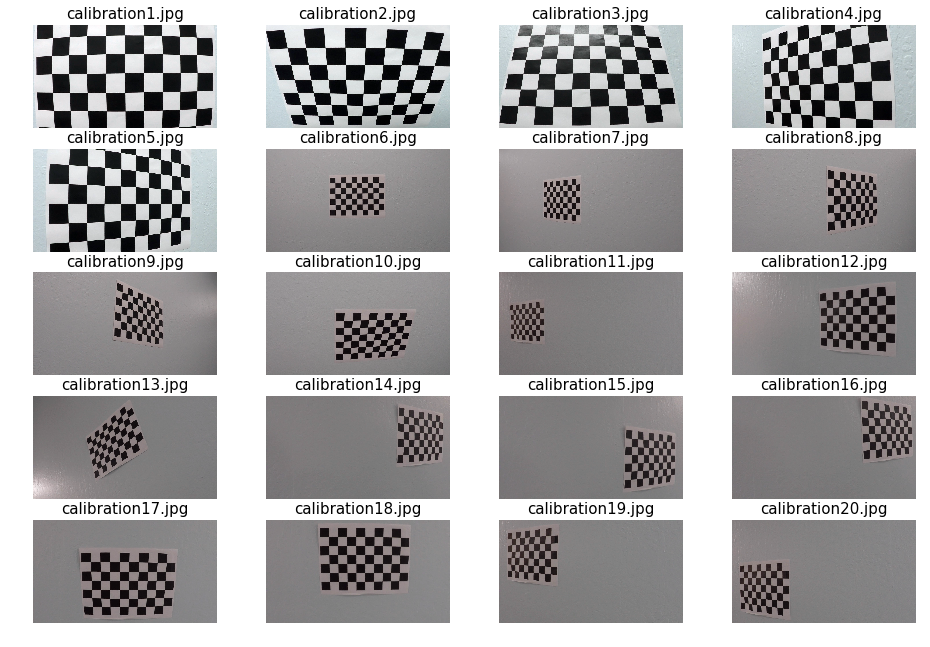

In [2]:
# Display Test Images for camera calibration

# File Load
cal_folder = 'camera_cal/'
cal_file = 'calibration'
cal_ext = '.jpg'
cal_files = [cal_file + str(f) + cal_ext for f in range(1, 21, 1)]

# Display
print('Num. of Test Images for calibration : {0}'.format(len(cal_files)))
fig, axs = plt.subplots(5,4, figsize=(16, 11))
axs = axs.ravel()

for i, fname in enumerate(cal_files):
    img = cv2.imread(str(cal_folder + fname))
    axs[i].set_title(fname, fontsize=15)
    axs[i].axis('off')
    axs[i].imshow(img)

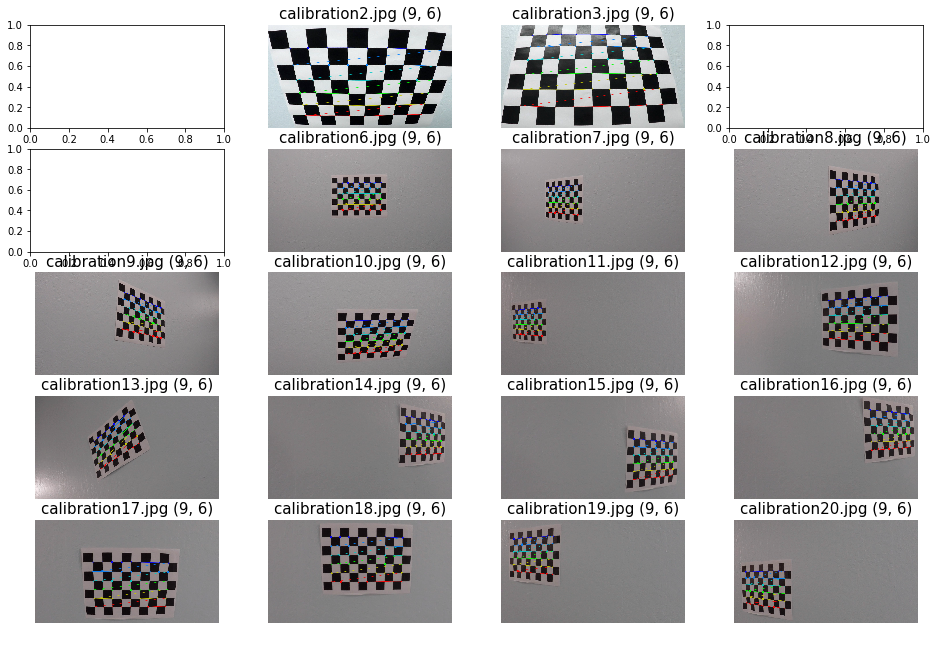

In [3]:
# Find Chessboard Corners
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

#point_num = [[9, 6], [9, 5], [9, 5], [8, 6], [8, 5], [8, 4]]
point_num = [[9, 6]]

fig, axs = plt.subplots(5,4, figsize=(16, 11))
axs = axs.ravel()

for i, fname in enumerate(cal_files):
    img = cv2.imread(str(cal_folder + fname))
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    #print(i, fname)
    for num in point_num:
        ret, corners = cv2.findChessboardCorners(gray, tuple(num), None)
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)
            
            img_corner = cv2.drawChessboardCorners(img, tuple(num), corners, ret)

            axs[i].set_title(fname + ' ' + str(tuple(num)), fontsize=15)
            axs[i].axis('off')
            axs[i].imshow(img_corner)
            break

#print(objpoints)
#print(imgpoints)
            

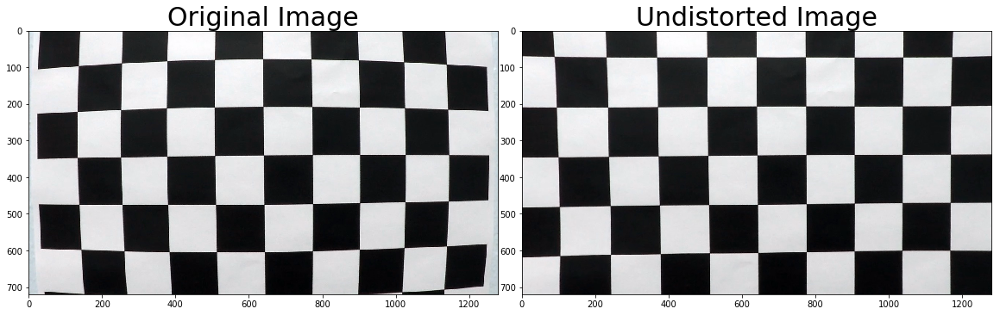

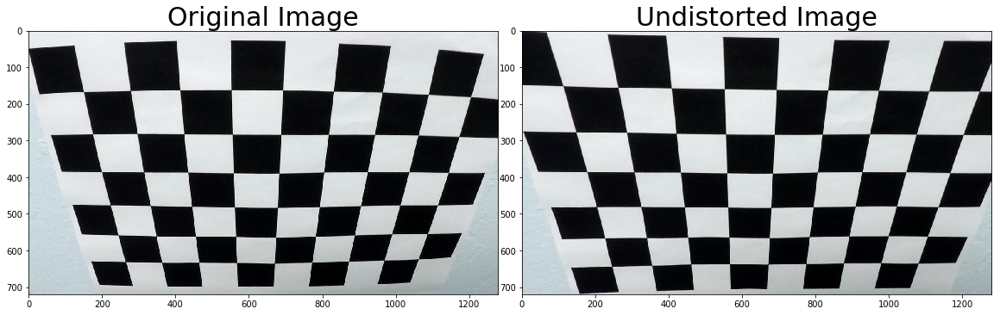

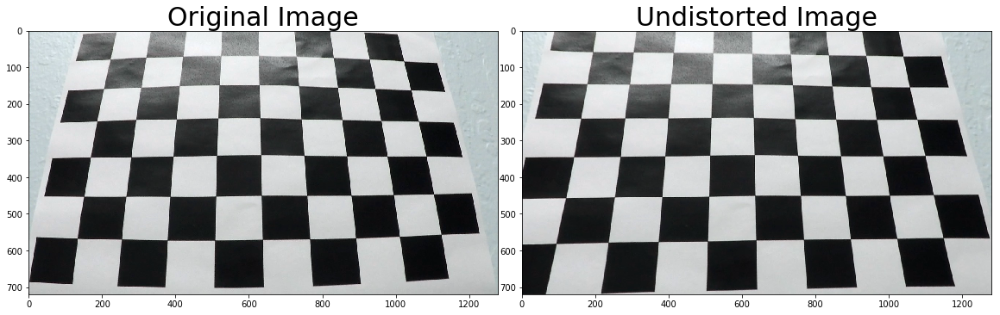

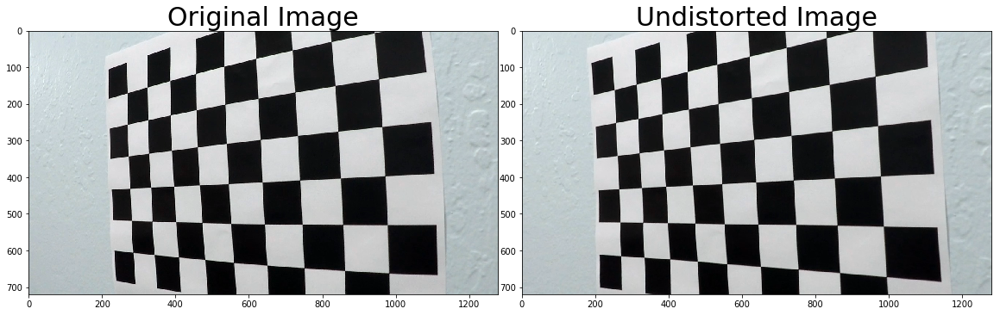

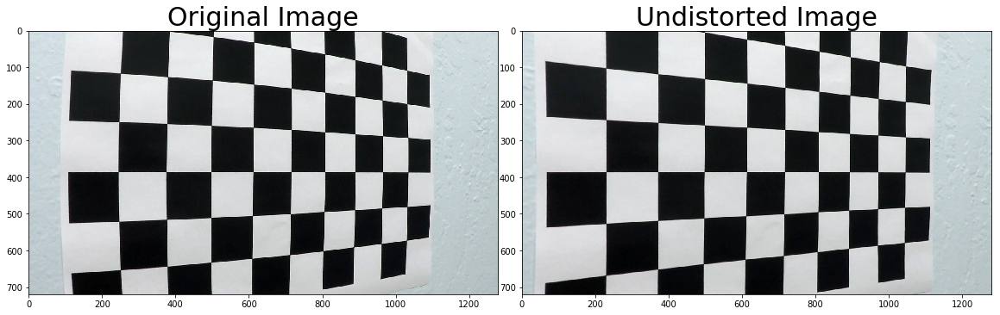

...

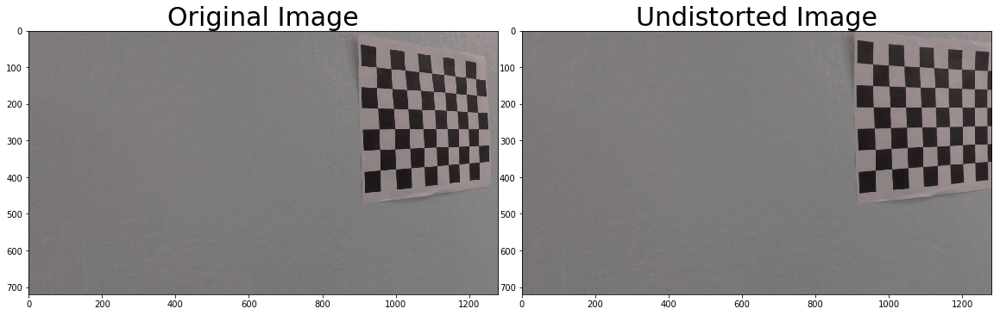

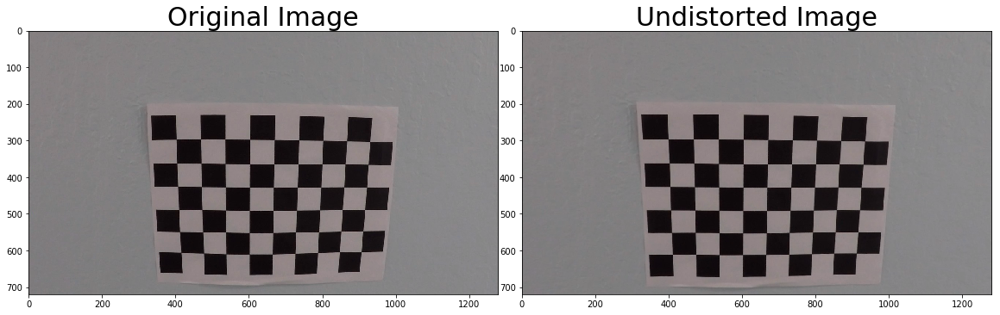

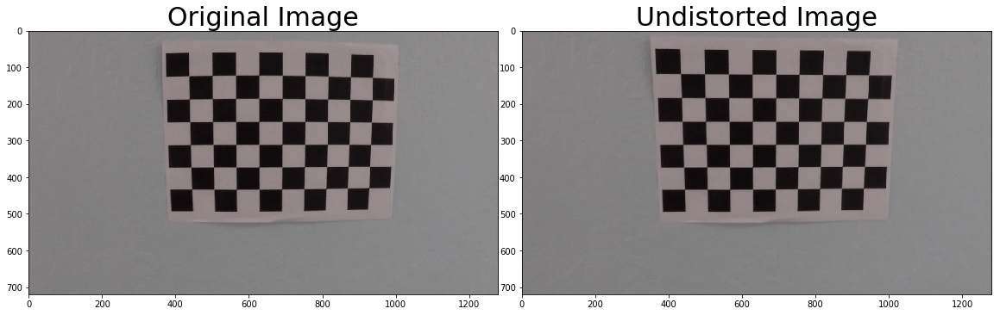

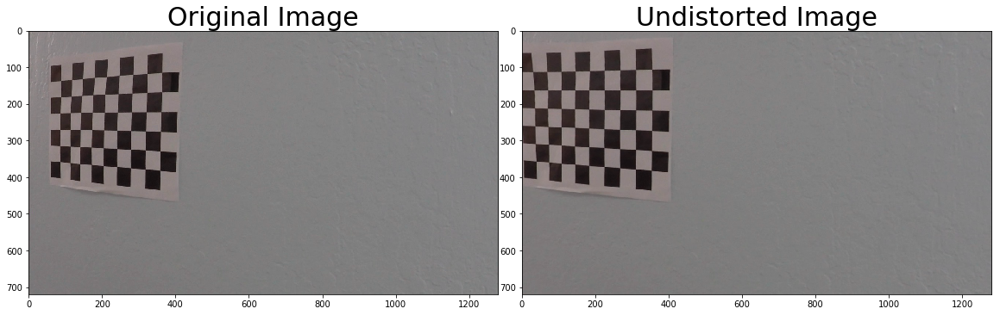

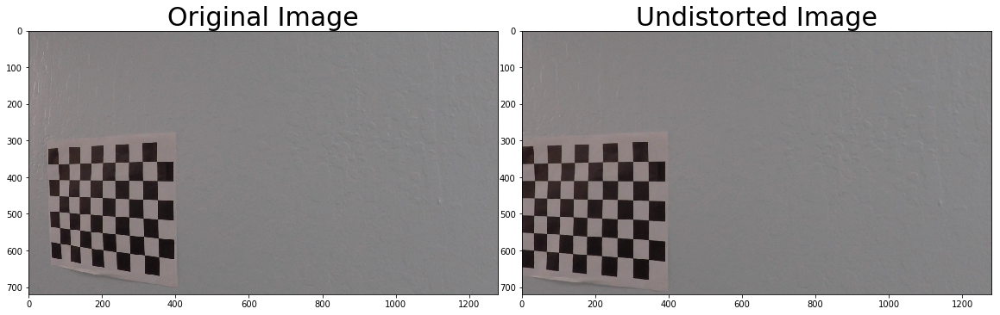

In [4]:
# Calibration
import pickle

for i, fname in enumerate(cal_files):
    img = cv2.imread(str(cal_folder + fname))
    img_size = (img.shape[1], img.shape[0])

    # Do camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
    dst = cv2.undistort(img, mtx, dist, None, mtx)

    # Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
    dist_pickle = {}
    dist_pickle["mtx"] = mtx
    dist_pickle["dist"] = dist
    #pickle.dump( dist_pickle, open( "calibration.p", "wb" ) )
    pickle.dump( dist_pickle, open( './output_images/calibration/' + cal_file + str(i+1) +'.p' , "wb" ) )
    #dst = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(dst)
    ax2.set_title('Undistorted Image', fontsize=30)
    #print('...')

/home/manadoona/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:58: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


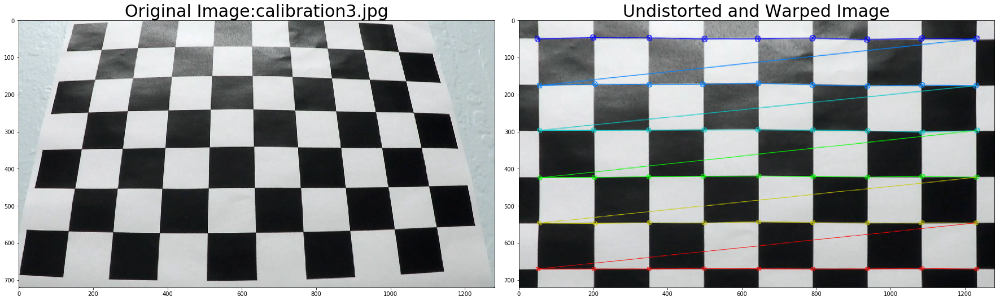

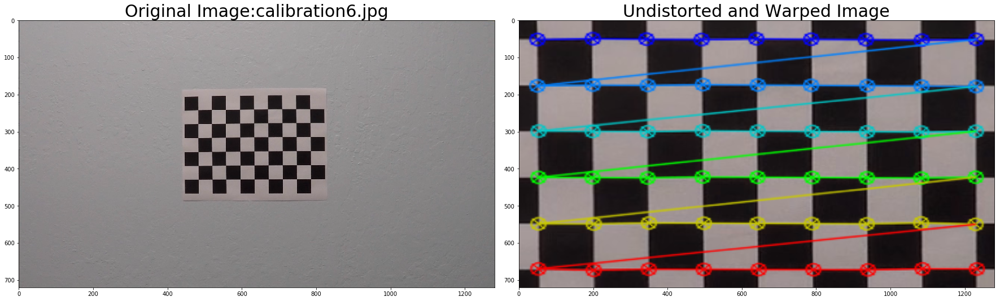

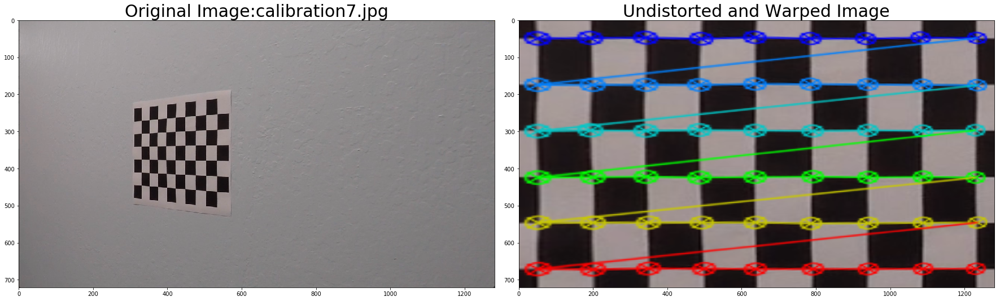

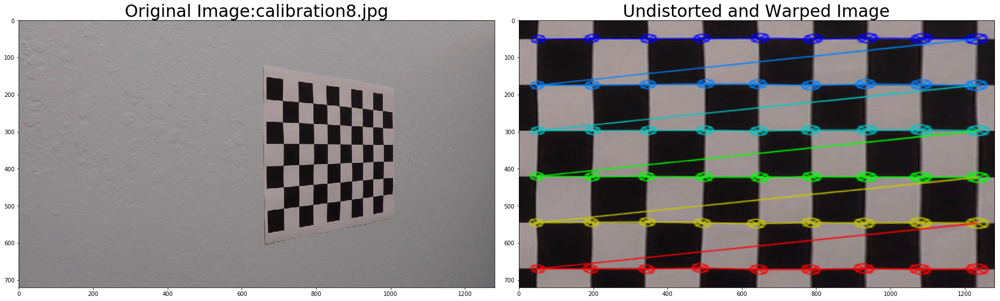

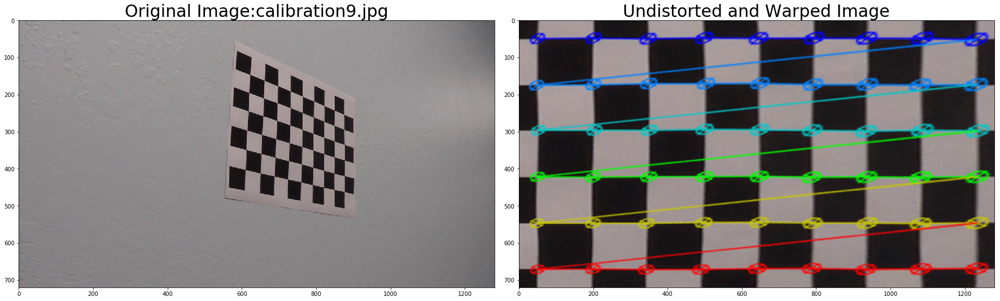

...

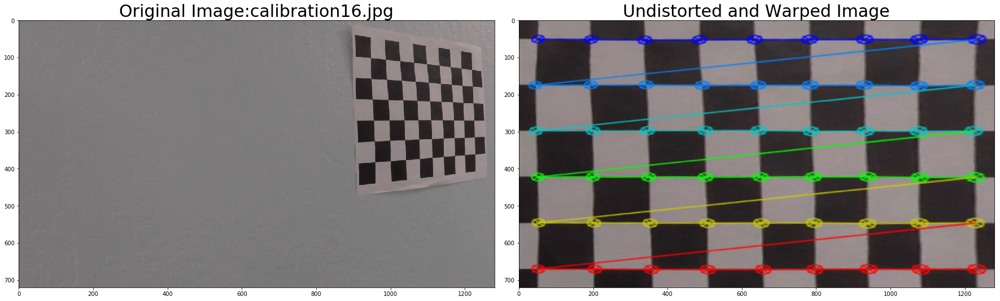

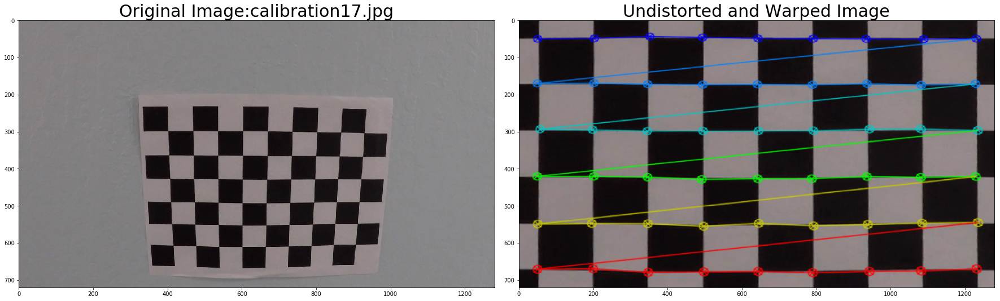

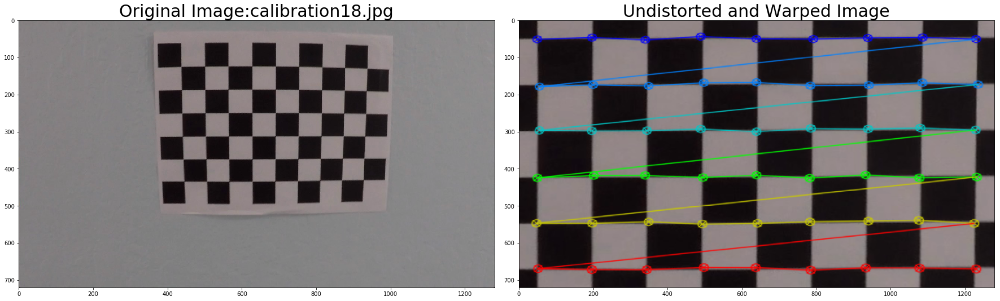

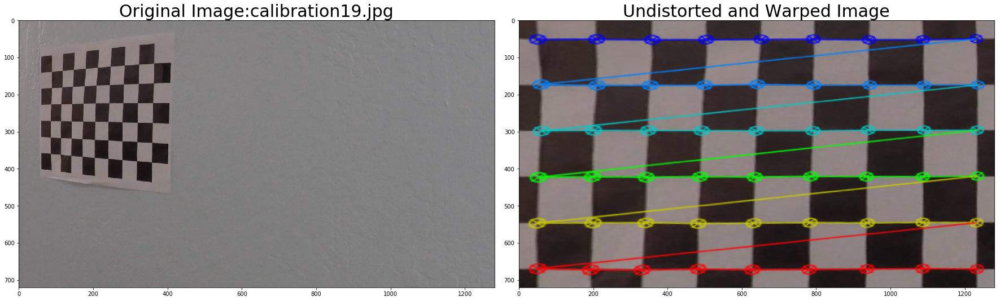

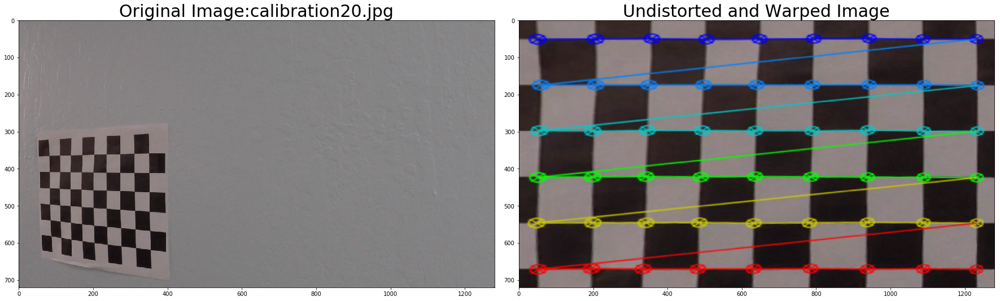

In [7]:
#Undist and Transform

# Read in the saved camera matrix and distortion coefficients
# These are the arrays you calculated using cv2.calibrateCamera()

nx = 9 # the number of inside corners in x
ny = 6 # the number of inside corners in y

# MODIFY THIS FUNCTION TO GENERATE OUTPUT 
# THAT LOOKS LIKE THE IMAGE ABOVE
def corners_unwarp(img, nx, ny, mtx, dist):
    # Pass in your image into this function
    # Write code to do the following steps
    # 1) Undistort using mtx and dist
    undist = cv2.undistort(img, mtx, dist, None, None)
    # 2) Convert to grayscale
    gray = cv2.cvtColor(undist,cv2.COLOR_BGR2GRAY)
    # 3) Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    
    warped = None
    M = None
    # 4) If corners found: 
    if ret == True:
        # If we found corners, draw them! (just for fun)
        cv2.drawChessboardCorners(undist, (nx, ny), corners, ret)
        # Choose offset from image corners to plot detected corners
        # This should be chosen to present the result at the proper aspect ratio
        # My choice of 100 pixels is not exact, but close enough for our purpose here
        offset = 50 # offset for dst points
        # Grab the image shape
        img_size = (gray.shape[1], gray.shape[0])

        # For source points I'm grabbing the outer four detected corners
        src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
        # For destination points, I'm arbitrarily choosing some points to be
        # a nice fit for displaying our warped result 
        # again, not exact, but close enough for our purposes
        dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
        # Given src and dst points, calculate the perspective transform matrix
        M = cv2.getPerspectiveTransform(src, dst)
        # Warp the image using OpenCV warpPerspective()
        warped = cv2.warpPerspective(undist, M, img_size)

    return warped, M

for i, fname in enumerate(cal_files):
    img = cv2.imread(str(cal_folder + fname))
    img_size = (img.shape[1], img.shape[0])

    dist_pickle = pickle.load( open( './output_images/calibration/' + cal_file + str(i+1) +'.p', "rb" ) )
    mtx = dist_pickle["mtx"]
    dist = dist_pickle["dist"]

    top_down, perspective_M = corners_unwarp(img, nx, ny, mtx, dist)
    if top_down != None:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24,9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image:'+fname, fontsize=30)
        ax2.imshow(top_down)
        ax2.set_title('Undistorted and Warped Image', fontsize=30)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


Num. of Images for Test : 8


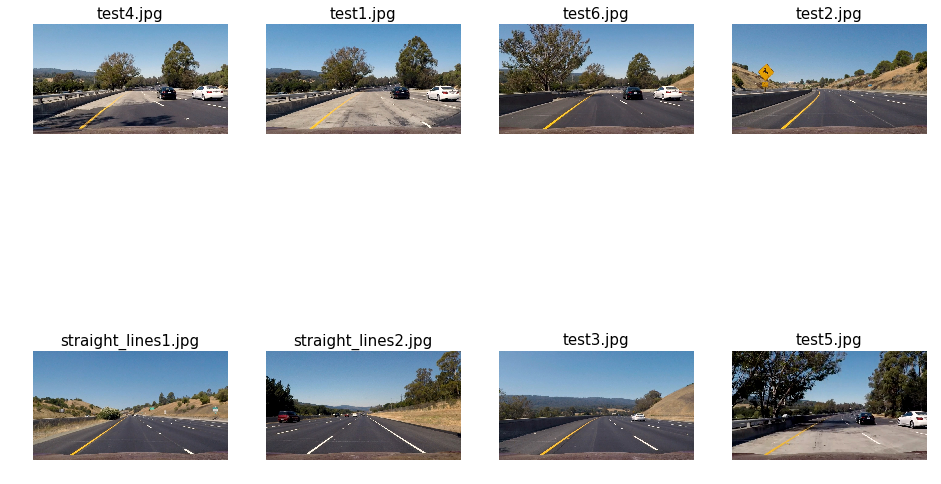

In [11]:
# File Load
test_folder = 'test_images/'
test_files = [f for f in os.listdir(test_folder)]

# Display
print('Num. of Images for Test : {0}'.format(len(test_files)))
fig, axs = plt.subplots(2,4, figsize=(16, 11))
axs = axs.ravel()

for i, fname in enumerate(test_files):
    img = cv2.imread(str(test_folder + fname))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    axs[i].set_title(fname, fontsize=15)
    axs[i].axis('off')
    axs[i].imshow(img)